In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

In [2]:
def pad_image(image, kernel, pad_type):
    height, width = kernel.shape
    pad_height = height // 2
    pad_width = width // 2
    
    if pad_type == 'clip':
        # Zero-padding
        padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='constant')
    elif pad_type == 'wrap':
        # Wrap around
        padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='wrap')
    elif pad_type == 'copy_edge':
        # Copy edge
        padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='edge')
    elif pad_type == 'reflect':
        # Reflect across edge
        padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='reflect')
    else:
        raise ValueError("Invalid padding type.")
    
    return padded_image

In [3]:
def conv2(image, kernel, pad_type):
    # Ensure the kernel is 2D
    assert len(kernel.shape) == 2, "Kernel must be 2D."

    # Add a dummy channel dimension for grayscale image to simulate RGB image
    if len(image.shape) == 2:
        image = image[:, :, np.newaxis]

    # Acquire the dimensions of the image and kernel
    height, width, channels = image.shape
    k_height, k_width = kernel.shape

    # Pad the image based on the padding type
    padded_image = pad_image(image, kernel, pad_type)

    # Initialize an output array
    output = np.zeros((height, width, channels))

    # Perform the convolution
    for c in range(channels):
        for i in range(height):
            for j in range(width):
                region = padded_image[i:i + k_height, j:j + k_width, c]
                output[i, j, c] = np.sum(region * kernel)

    # Remove the dummy channel dimension for grayscale image
    if output.shape[2] == 1:
        output = output[:, :, 0]

    return output

In [4]:
def create_impulse_image(size, position):
    image = np.zeros(size)
    image[position] = 1  # Unit impulse
    return image

In [5]:
# Define desired kernel
kernel = np.ones((3, 3)) / 9  # Box filter
# The simple first order derivative filters
kernel2 = np.array([-1,1])
kernel3 = np.array([[-1],[1]])
kernel4 = np.array([[-1],[1]])
# The six filters
kernel5 = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
kernel6 = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
kernel7 = np.array([[-1,0,1],[-2,0,2],[-1,0,1]])
kernel8 = np.array([[1,2,1],[0,0,0],[-1,-2,1]])
kernel9 = np.array([[0,1],[-1,0]])
kernel10 = np.array([[1,0],[0,-1]])

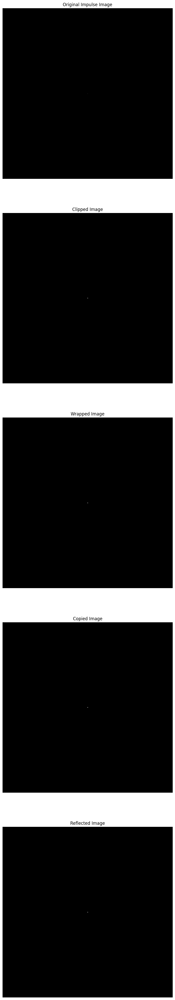

In [6]:
# Create an impulse image
impulse_image = create_impulse_image((1024, 1024), (512, 512))
# impulse_image = create_impulse_image((100, 100), (50, 50))

# Perform 4-types of convolution on the impulse image
clip_image = conv2(impulse_image, kernel, 'clip')
wrap_image = conv2(impulse_image, kernel, 'wrap')
copy_image = conv2(impulse_image, kernel, 'copy_edge')
reflect_image = conv2(impulse_image, kernel, 'reflect')

plt.figure(figsize=(25, 50))
plt.subplot(5, 1, 1)
plt.imshow(impulse_image, cmap='gray')
plt.title('Original Impulse Image')
plt.axis('off')

plt.subplot(5, 1, 2)
plt.imshow(clip_image, cmap='gray')
plt.title('Clipped Image')
plt.axis('off')

plt.subplot(5, 1, 3)
plt.imshow(wrap_image, cmap='gray')
plt.title('Wrapped Image')
plt.axis('off')

plt.subplot(5, 1, 4)
plt.imshow(copy_image, cmap='gray')
plt.title('Copied Image')
plt.axis('off')

plt.subplot(5, 1, 5)
plt.imshow(reflect_image, cmap='gray')
plt.title('Reflected Image')
plt.axis('off')

plt.show()


In [7]:
# use OpenCV to read dimensional values of image
image_gray = cv2.imread("wolves.png", cv2.IMREAD_GRAYSCALE)
# cv2.imshow("image", image_gray)
# cv2.waitKey(0)
print('Shape: ', image_gray.shape)
print('Size: ', image_gray.size)

Shape:  (539, 1500)
Size:  808500


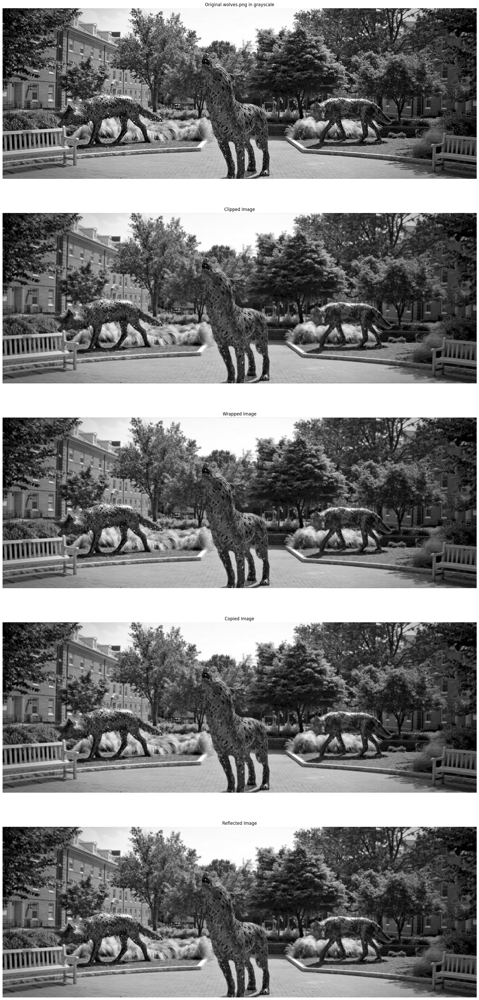

In [8]:
# Perform 4-types of convolution on the image
clip_image_ = conv2(image_gray, kernel, 'clip')
wrap_image_ = conv2(image_gray, kernel, 'wrap')
copy_image_ = conv2(image_gray, kernel, 'copy_edge')
reflect_image_ = conv2(image_gray, kernel, 'reflect')

plt.figure(figsize=(25, 50))
plt.subplot(5, 1, 1)
plt.imshow(image_gray, cmap='gray')
plt.title('Original wolves.png in grayscale')
plt.axis('off')

plt.subplot(5, 1, 2)
plt.imshow(clip_image_, cmap='gray')
plt.title('Clipped Image')
plt.axis('off')

plt.subplot(5, 1, 3)
plt.imshow(wrap_image_, cmap='gray')
plt.title('Wrapped Image')
plt.axis('off')

plt.subplot(5, 1, 4)
plt.imshow(copy_image_, cmap='gray')
plt.title('Copied Image')
plt.axis('off')

plt.subplot(5, 1, 5)
plt.imshow(reflect_image_, cmap='gray')
plt.title('Reflected Image')
plt.axis('off')

plt.show()

In [9]:
# use OpenCV to read dimensional values of image
image_rgb = cv2.imread("wolves.png", cv2.IMREAD_UNCHANGED)
image_rgb = image_rgb[:, :, ::-1] # BGR to RGB
# imgplot = cv2.imshow("image", image_rgb)
# cv2.waitKey(0)
print('Shape: ', image_rgb.shape)
print('Size: ', image_rgb.size)

Shape:  (539, 1500, 3)
Size:  2425500


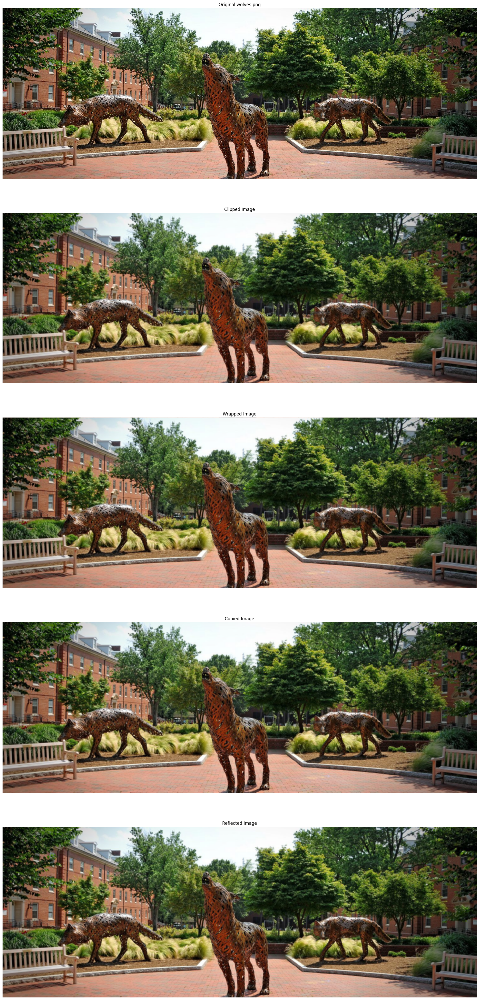

In [10]:
# Perform 4-types of convolution on the image
clip_image__ = conv2(image_rgb, kernel, 'clip')
wrap_image__ = conv2(image_rgb, kernel, 'wrap')
copy_image__ = conv2(image_rgb, kernel, 'copy_edge')
reflect_image__ = conv2(image_rgb, kernel, 'reflect')

plt.figure(figsize=(25, 50))
plt.subplot(5, 1, 1)
plt.imshow(image_rgb)
plt.title('Original wolves.png')
plt.axis('off')

plt.subplot(5, 1, 2)
plt.imshow(clip_image__.astype(np.uint8))
plt.title('Clipped Image')
plt.axis('off')

plt.subplot(5, 1, 3)
plt.imshow(wrap_image__.astype(np.uint8))
plt.title('Wrapped Image')
plt.axis('off')

plt.subplot(5, 1, 4)
plt.imshow(copy_image__.astype(np.uint8))
plt.title('Copied Image')
plt.axis('off')

plt.subplot(5, 1, 5)
plt.imshow(reflect_image__.astype(np.uint8))
plt.title('Reflected Image')
plt.axis('off')

plt.show()